### Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

In [2]:
from skimage import img_as_ubyte
from skimage.color import rgb2gray, rgb2hsv
from skimage.exposure import equalize_hist, rescale_intensity, adjust_sigmoid, adjust_log, histogram, is_low_contrast, match_histograms
from skimage.filters import threshold_otsu, rank, median
from skimage.feature import canny
from skimage.segmentation import clear_border
from skimage.morphology import dilation, erosion, closing, opening, binary_closing, binary_opening, convex_hull_image, disk, square
from scipy.ndimage import binary_fill_holes, binary_erosion, binary_dilation
from skimage.util import invert

In [3]:
def list_get(list_, ind_, default_):
  try:
    return list_[ind_]
  except IndexError:
    return default_

In [4]:
def show_images(img_arr, name_arr=[], n_in_row=3, factor_r=4, factor_c=4, figsize=None,
         title=None, cmap_='Greys', label_fontsize=12, tick_fontsize=11, save_path=None):
    if type(img_arr) is np.ndarray:
        quant = img_arr.shape[0]
    elif type(img_arr) is list:
        quant = len(img_arr)
    cols = min(quant, n_in_row)
    rows = quant // n_in_row + (1 if quant % n_in_row else 0)
    if figsize is None:
        figsize = (int(factor_c * cols), int(factor_r * rows))
    fig = plt.figure(figsize=figsize)
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    for i, img in enumerate(img_arr):
        ax = fig.add_subplot(rows, cols, i + 1)
        ax.imshow(img, cmap=cmap_)
        ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
        ax.xaxis.set_ticks_position('top')
        ax.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(f'{save_path}')
    plt.show()

In [5]:
def show_image(img, name='', factor_r=4, factor_c=4, figsize=None, n_in_row=3,
         title=None, cmap_='Greys', label_fontsize=12, tick_fontsize=11, save_path=None):
    if figsize is None:
        figsize = (int(factor_c), int(factor_r))
    fig = plt.figure(figsize=figsize)
    fig = plt.figure(figsize=(factor_c, factor_r))
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    plt.imshow(img, cmap=cmap_)
    plt.xlabel(name, fontsize=label_fontsize)
    plt.gca().xaxis.set_ticks_position('top')
    plt.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(f'{save_path}')
    return plt

In [6]:
def to_1ch(img, mode='gray'):
    transf_1ch = (
        {'r': lambda img: img[:, :, 0],
         'g': lambda img: img[:, :, 1],
         'b': lambda img: img[:, :, 2],
         'h': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 0]),
         's': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 1]),
         'v': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 2]),
         'gray': lambda img: img_as_ubyte(rgb2gray(img))}
    )
    return transf_1ch[mode](img)

In [7]:
def get_all_transf(img, transf_arr, transf_names=[], src=None):
    img_arr = []
    for transf in transf_arr:
        img_arr.append(transf(img))
    name_arr = transf_names
    if src is not None:
        img_arr.append(img)
        name_arr.append(src)
    return img_arr, name_arr

In [8]:
def get_transf_of_all(images, transf, transf_names=[], src=None):
    img_arr = []
    for img in images:
        img_arr.append(transf(img))
    name_arr = transf_names
    if src is not None:
        img_arr.append(img)
        name_arr.append(src)
    return img_arr, name_arr

In [9]:
def square_kern(n):
    return np.ones((n,n)) == 1

In [10]:
def diamond_kern(n):
    if n == 2:
        return square_kern(n)
    a = np.arange(n)
    a = np.minimum(a,a[::-1])
    return (a[:,None] + a) >= (n-1) // 2

In [11]:
def to_bin(img, thr='otsu'):
    if thr == 'otsu':
        return img > threshold_otsu(img)
    else:
        return img > 255 * thr

In [12]:
def clear_card(img):
    # mask_1
    grayscale_ = to_1ch(img, mode='h')
    contrast_ = adjust_sigmoid(grayscale_, cutoff=0.6)
    bin_ = to_bin(contrast_, thr='otsu')
    invert_ = invert(bin_)
    morph_ = opening(invert_, diamond_kern(4))
    mask_1 = morph_
#     show_images([contrast_, bin_, invert_, morph_, mask_1])
    
    # mask_2
    grayscale_ = to_1ch(img, mode='h')
    contrast_ = adjust_sigmoid(grayscale_, cutoff=0.6)
    bin_ = to_bin(contrast_, thr=0.62)
    morph_ = opening(bin_, square_kern(5))
    mask_2 = morph_
#     show_images([mask_2])
    
    res = mask_1 + mask_2
    return res

## Решение

### Выделение карточек

In [626]:
input_folder = '.'
input_file = 'input/IMG_4.jpg'

In [627]:
img_orig = np.array(Image.open(f'{input_folder}/{input_file}'))

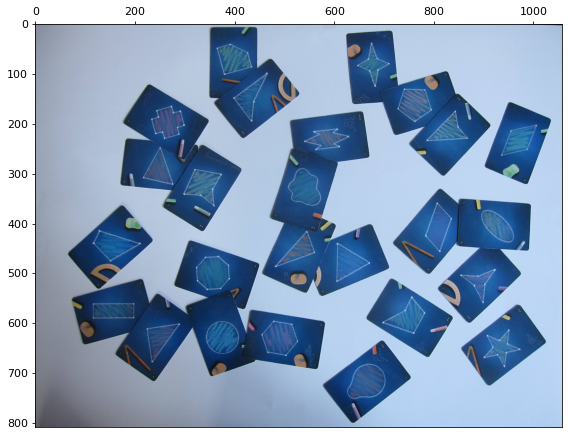

In [628]:
show_images([img_orig], factor_r = 7, factor_c = 8)

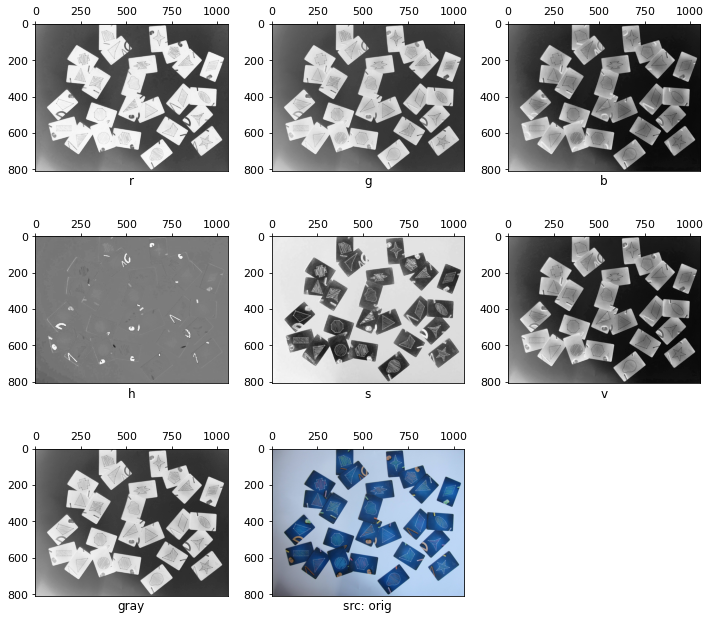

In [629]:
transf_1ch_names = ['r', 'g', 'b', 'h', 's', 'v', 'gray']
transf_1ch_arr = [(lambda img, mode=mode_: to_1ch(img, mode=mode)) for mode_ in transf_1ch_names]

images_1ch = get_all_transf(img_orig, transf_1ch_arr, transf_1ch_names, src='src: orig')
show_images(*images_1ch, factor_r=3, factor_c=3.5)

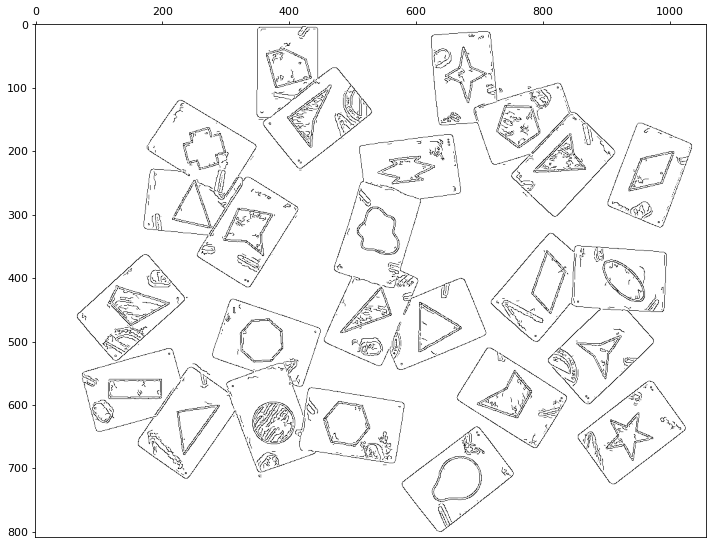

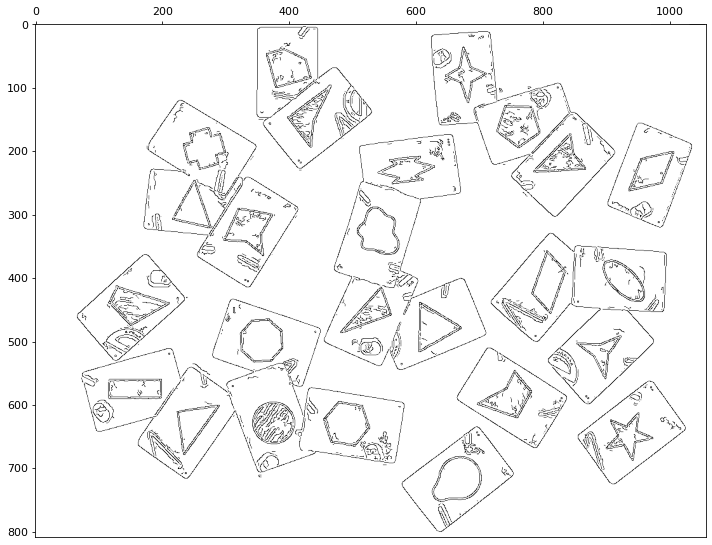

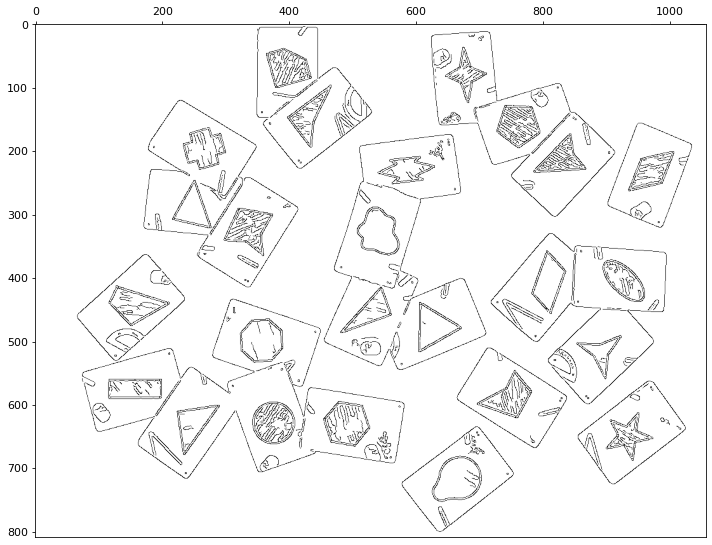

In [647]:
show_image(canny(to_1ch(img_orig, mode='b'), sigma=0.7), factor_r=8, factor_c=10).show()
show_image(canny(to_1ch(img_orig, mode='v'), sigma=0.7), factor_r=8, factor_c=10).show()
show_image(canny(to_1ch(img_orig, mode='gray'), sigma=0.7), factor_r=8, factor_c=10).show()

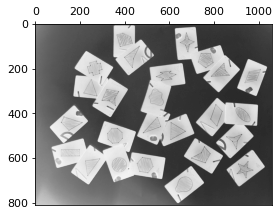

In [630]:
img_ = images_1ch[0][6]
show_images([img_])

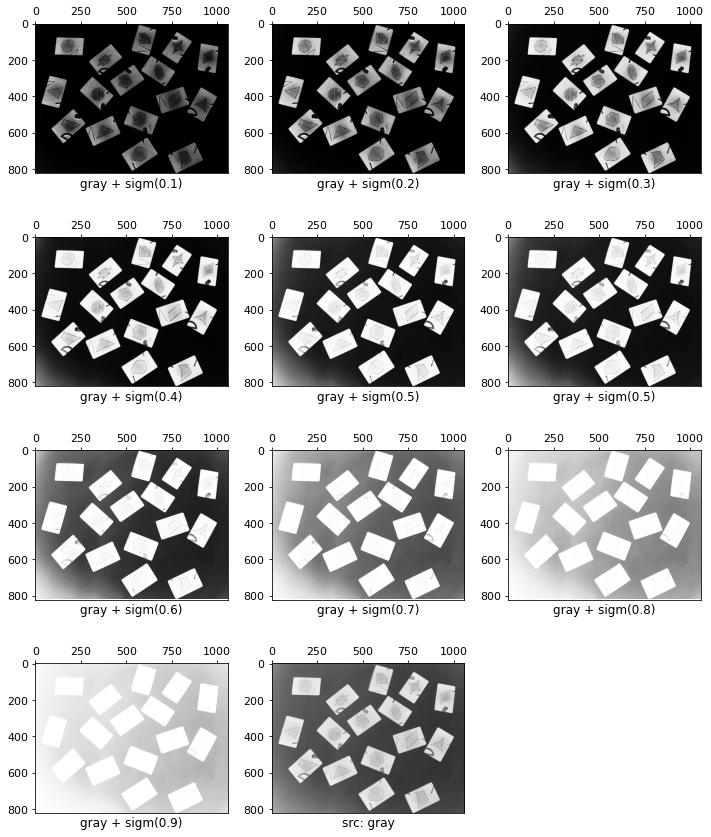

In [51]:
transf_sigm_names = list(np.linspace(0.1, 0.9, 10).round(1))
transf_sigm_arr = [(lambda img, cutoff=cutoff_: adjust_sigmoid(img, cutoff=cutoff)) for cutoff_ in transf_sigm_names]
transf_sigm_names = [f'gray + sigm({s})' for s in transf_sigm_names]

img_sigm = get_all_transf(img_, transf_sigm_arr, transf_sigm_names, src='src: gray')
show_images(*img_sigm, factor_r=3, factor_c=3.5)

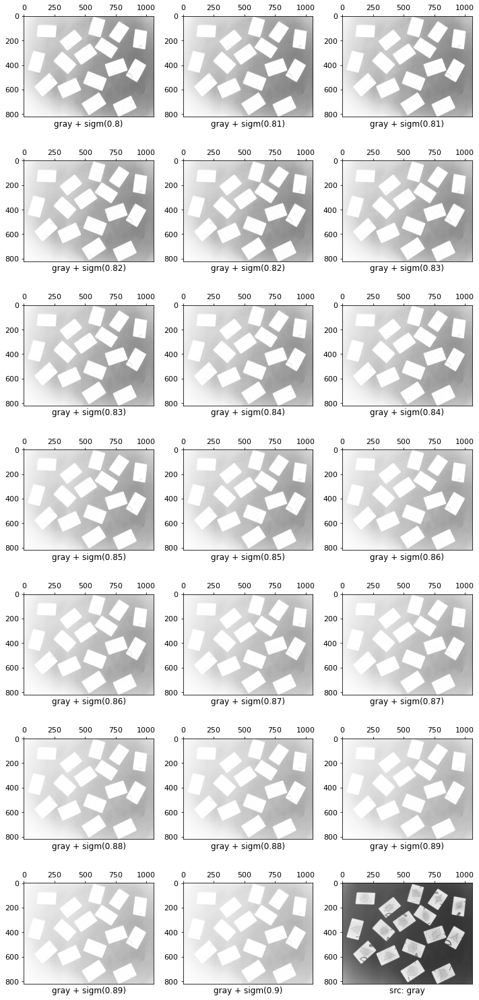

In [55]:
transf_sigm_names = list(np.linspace(0.8, 0.9, 20).round(2))
transf_sigm_arr = [(lambda img, cutoff=cutoff_: adjust_sigmoid(img, cutoff=cutoff)) for cutoff_ in transf_sigm_names]
transf_sigm_names = [f'gray + sigm({s})' for s in transf_sigm_names]

img_sigm = get_all_transf(img_, transf_sigm_arr, transf_sigm_names, src='src: gray')
show_images(*img_sigm, factor_r=3, factor_c=3.5)

In [13]:
images_ = img_sigm

transf_canny_names = [s + ' + canny' for s in transf_sigm_names]

images_canny = get_transf_of_all(images_[0], lambda img: canny(img), transf_canny_names)
show_images(*images_canny, factor_r=3, factor_c=3.5)

# img = binary_closing(img, disk(3))
#     img = binary_fill_holes(img, disk(1))
#     if remove_border:
#         img = clear_border(img)
#     img = binary_erosion(img, disk(erosion_radius))
# images_res = get_transf_of_all(images_canny[0], lambda img: binary_opening(img, disk(3)), transf_canny_names)
# show_images(*images_res, factor_r=3, factor_c=3.5)

NameError: name 'img_sigm' is not defined

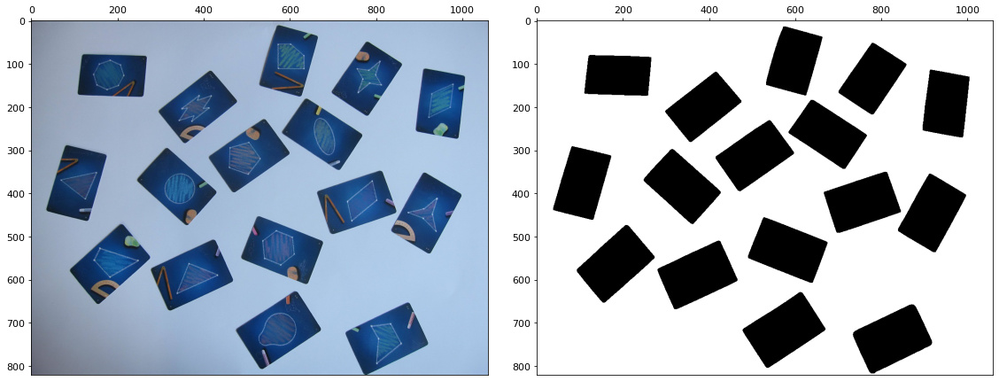

In [975]:
def mask_objects(img, closing_r=5, opening_r=12, erosion_r=3):
    img = to_1ch(img, mode='gray')
    img = adjust_sigmoid(img, cutoff=0.9)
    img = canny(img)
    img = binary_fill_holes(img, disk(1))
    mask_1 = binary_opening(img, disk(3)) * clear_border(binary_closing(img, disk(3)))
    mask_2 = binary_opening(binary_fill_holes(binary_closing(img, disk(closing_r)) ^
                            clear_border(binary_closing(img, disk(closing_r))), disk(1)), disk(opening_r))
    img = mask_1 + mask_2
    img = binary_erosion(img, disk(erosion_r))
    return img
img_ = np.array(Image.open(f'input/IMG_1.jpg'))
show_images([img_, mask_objects(img_)], factor_r=6, factor_c=8)

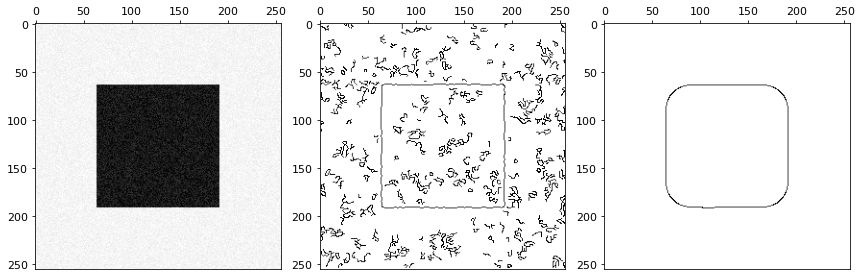

In [704]:
rng = np.random.default_rng()
# Generate noisy image of a square
im = np.zeros((256, 256))
im[64:-64, 64:-64] = 1
im += 0.2 * rng.random(im.shape)
# First trial with the Canny filter, with the default smoothing
edges1 = feature.canny(im)
# Increase the smoothing for better results
edges2 = feature.canny(im, sigma=16)
show_images([im, edges1, edges2])

In [706]:
images = []
names = []
for i in [1, 2, 4, 6, 7, 9, 10]:
    name = f'IMG_{i}'
    images.append(np.array(Image.open(f'input/{name}.jpg')))
    names.append(name)

In [978]:
def mask_objects(img, sigmoid_thr=0.5, canny_sigma=0.7, closing_r=5, opening_r=15, erosion_r=3):
    img = to_1ch(img, mode='b')
    img = adjust_sigmoid(img, cutoff=sigmoid_thr)
    img = canny(img, sigma=canny_sigma)
    img = binary_closing(img, disk(closing_r))
    img = binary_fill_holes(img, disk(1))
    img = binary_opening(img, disk(opening_r))
    img = binary_erosion(img, disk(erosion_r))
    return img

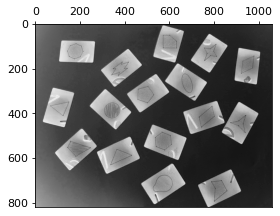

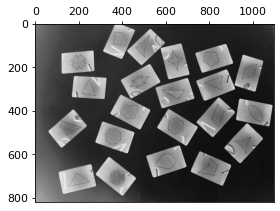

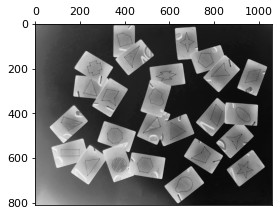

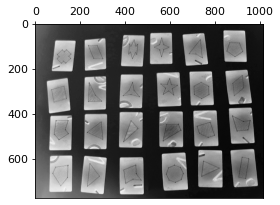

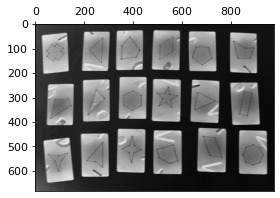

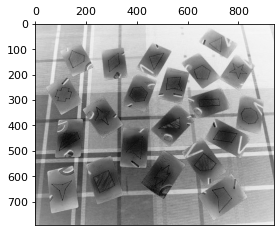

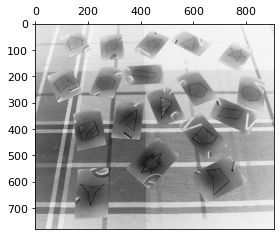

In [984]:
img_arr = []
name_arr = []
for img, name in zip(images[:], names):
    mask = mask_objects(img)
    img_arr += [img, mask, to_1ch(img) * mask]
    name_arr += [name, f'mask of {name}', f'masked gray {name}']

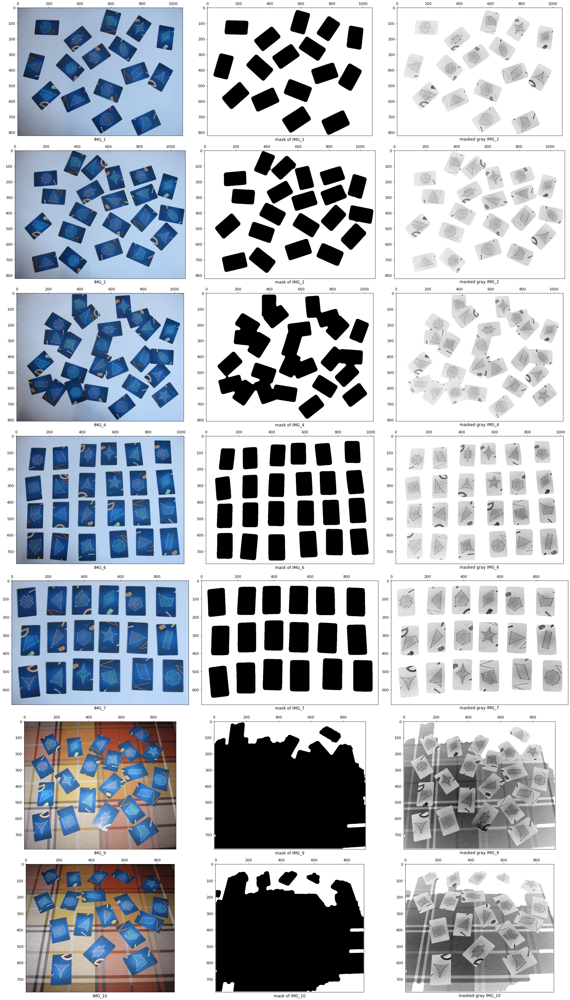

In [980]:
show_images(img_arr, name_arr, n_in_row=3, factor_r=6, factor_c=8)

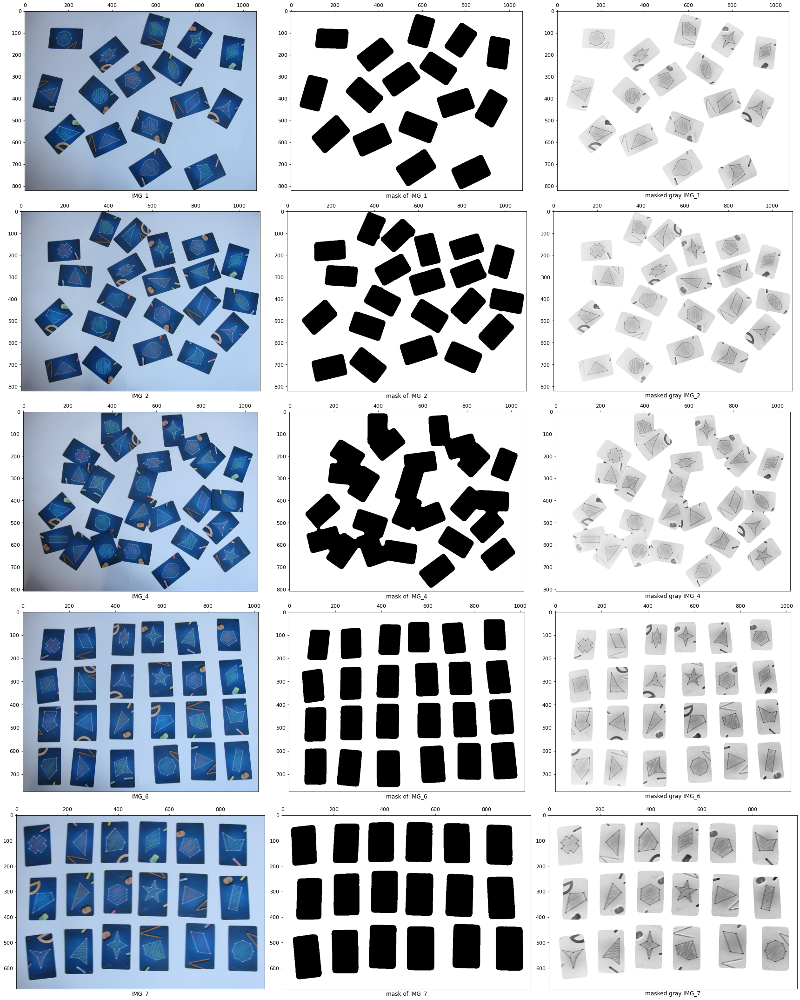

In [696]:
show_images(img_arr, name_arr, n_in_row=3, factor_r=6, factor_c=8)

In [707]:
img_arr = []
name_arr = []
for img, name in zip(images[-2:], names):
    mask = mask_objects(img)
    img_arr += [img, mask, to_1ch(img) * mask]
    name_arr += [name, f'mask of {name}', f'masked gray {name}']

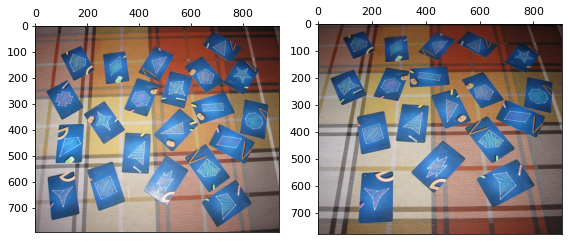

In [717]:
img_arr_ = images[-2:]
show_images(img_arr_)

In [722]:
img_ = img_arr_[1]

In [14]:
def show_images(img_arr, name_arr=[], n_in_row=3, factor_r=4, factor_c=4, figsize=None,
         title=None, cmap_='Greys', label_fontsize=12, tick_fontsize=11, save_path=None):
    if type(img_arr) is np.ndarray:
        quant = img_arr.shape[0]
    elif type(img_arr) is list:
        quant = len(img_arr)
    cols = min(quant, n_in_row)
    rows = quant // n_in_row + (1 if quant % n_in_row else 0)
    if figsize is None:
        figsize = (int(factor_c * cols), int(factor_r * rows))
    fig = plt.figure(figsize=figsize)
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    for i, img in enumerate(img_arr):
        ax = fig.add_subplot(rows, cols, i + 1)
        if type(img) is tuple:
            x, y = img
            ax.plot(x, y)
            ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
        else:
            ax.imshow(img, cmap=cmap_)
            ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
            ax.xaxis.set_ticks_position('top')
            ax.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(f'{save_path}')
    plt.show()

In [ ]:
skimage.exposure.match_histograms

C:\Users\Kirill\anaconda3\envs\py36\lib\site-packages\ipykernel_launcher.py:1: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel.
  """Entry point for launching an IPython kernel.


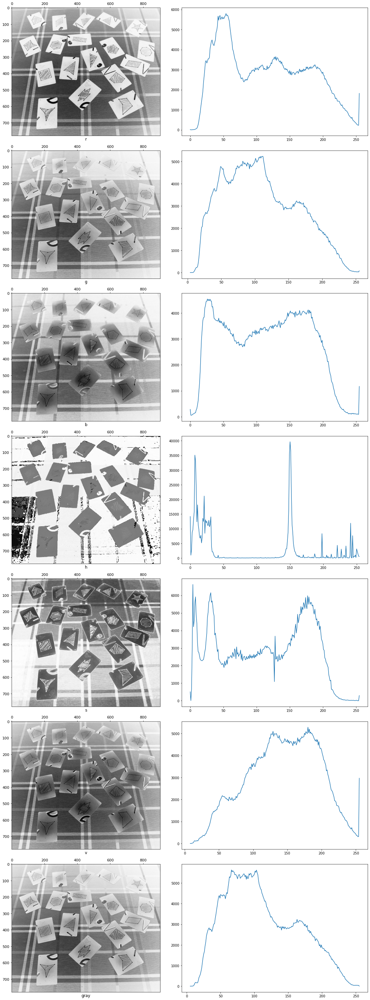

In [938]:
hist, hist_centers = histogram(img_)

# fig = plt.figure(figsize=(8, 3))
# show_images([img_, (hist_centers, hist)], factor_r=6, factor_c=8)
# plt.plot(hist_centers, hist, lw=2)

img_ = img_arr_[1]
transf_1ch_names = ['r', 'g', 'b', 'h', 's', 'v', 'gray']
transf_1ch_arr = [(lambda img, mode=mode_: to_1ch(img, mode=mode)) for mode_ in transf_1ch_names]

i_, n_ = get_all_transf(img_, transf_1ch_arr, transf_1ch_names, src='src: orig')

img_arr = []
name_arr = []

for img, name in zip(i_[:-1], n_[:-1]):
    hist, hist_centers = histogram(img)
    img_arr += [img, (hist_centers, hist)]
    name_arr += [name, f'{name} hist']    

show_images(img_arr, name_arr, n_in_row=2, factor_r=6, factor_c=8)

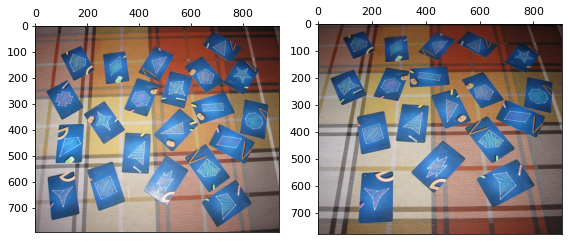

In [990]:
show_images(img_arr_)

In [15]:
src_images = []
src_names = []
for i in [1, 2, 4, 6, 7, 9, 10]:
    name = f'IMG_{i}'
    src_images.append(np.array(Image.open(f'input/{name}.jpg')))
    src_names.append(name)

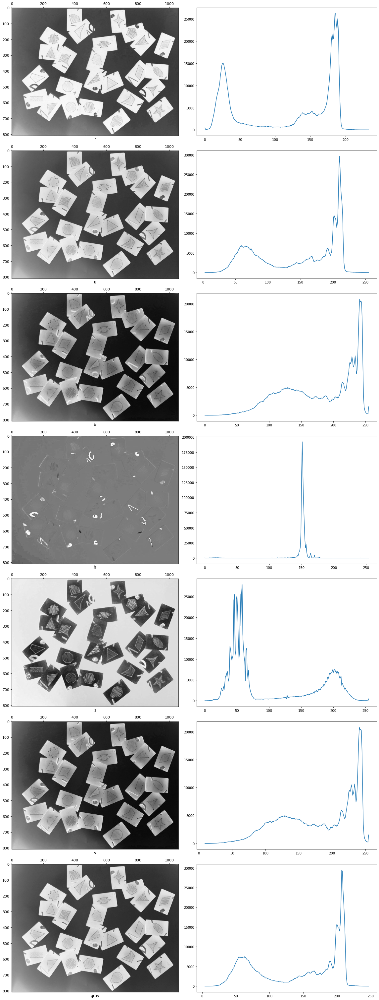

In [993]:
img_ = src_images[2]
transf_1ch_names = ['r', 'g', 'b', 'h', 's', 'v', 'gray']
transf_1ch_arr = [(lambda img, mode=mode_: to_1ch(img, mode=mode)) for mode_ in transf_1ch_names]

i_, n_ = get_all_transf(img_, transf_1ch_arr, transf_1ch_names, src='src: orig')

img_arr = []
name_arr = []

for img, name in zip(i_[:-1], n_[:-1]):
    hist, hist_centers = histogram(img)
    img_arr += [img, (hist_centers, hist)]
    name_arr += [name, f'{name} hist']    

show_images(img_arr, name_arr, n_in_row=2, factor_r=6, factor_c=8)

In [755]:
img_ = img_arr_[1]
y_, x_ = histogram(img_)

C:\Users\Kirill\anaconda3\envs\py36\lib\site-packages\ipykernel_launcher.py:2: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel.
  


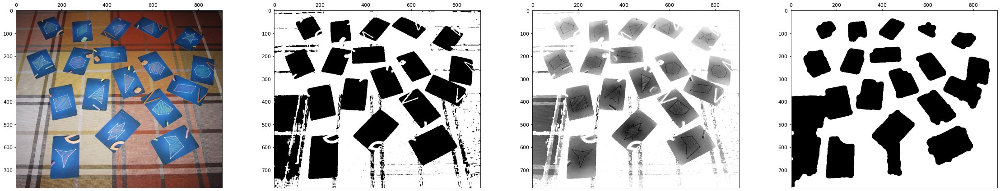

In [997]:
i_ = []
img = src_images[6]
bg = bg_filter(img)
res_1 = to_1ch(img, mode='b') * bg
i_ += [img, bg, res_1, mask_objects(img, bg)]

show_images(i_, n_in_row=4, factor_r=6, factor_c=8)

In [66]:
# i_ = to_1ch(img_, mode='h')

def bg_filter(img, thr_a=0, thr_b=255, print_=False, factor=0.4):
    y, x = histogram(img)
    x, y = np.array(x), np.array(y)
    x, y = x[thr_a:thr_b+1], y[thr_a:thr_b+1]

    y_mean = np.mean(y)
    y_med = np.median(y)
    thr = y_med + np.abs(y_mean - y_med) * factor

    i0 = np.argmax(y)  
    i1, i2 = i0, i0
    i_min, i_max = 0, thr_b - thr_a

    for i in range(i0, i_min - 1, -1):
        if not (y[i] > thr):
            i1 = i
            break
        
    for i in range(i0, i_max + 1):
        if not (y[i] > thr):
            i2 = i
            break
            
    x1, x2 = x[i1], x[i2]
    

    if print_:
        y_mean_arr = np.full_like(y, y_mean)
        y_med_arr = np.full_like(y, y_med)
        thr_arr = np.full_like(y, thr)
        fig = plt.figure(figsize=(10, 6))
        plt.plot(x, y, label='y, histogram')
        plt.plot(x, y_mean_arr, label='y mean')
        plt.plot(x, y_med_arr, label='y median')
        plt.plot(x, thr_arr, label='threshold')
        plt.plot(x1, y[i1], 'bo', label='left bound')
        plt.plot(x2, y[i2], 'ro', label='right bound')
        plt.legend()
        plt.show()

    img = (img >= x1) & (img <= x2)
    img = binary_fill_holes(img, disk(1))
    return img

def mask_objects_2(img, sigmoid_thr=0.5, canny_sigma=0.5, closing_r=5, opening_r=15, erosion_r=3):
    show_image(img)
#     img = adjust_sigmoid(img, cutoff=sigmoid_thr)
#     show_image(img)
    img = canny(img, sigma=canny_sigma)
    show_image(img)
    img = binary_closing(img, disk(closing_r))
    img = binary_fill_holes(img, disk(1))
    img = binary_opening(img, disk(opening_r))
#     img = binary_erosion(img, disk(erosion_r))
    return img

def mask_objects_3(img, sigmoid_thr=0.5, canny_sigma=0.5, closing_r=5, opening_r=15, erosion_r=3):
    img = to_1ch(img, mode='s')
#     show_image(img)
#     img = adjust_sigmoid(img, cutoff=sigmoid_thr)
#     show_image(img)
    img = canny(img, sigma=canny_sigma)
#     show_image(img)
    img = binary_closing(img, disk(closing_r))
    img = binary_fill_holes(img, disk(1))
#     show_image(img)
    img = binary_opening(img, disk(opening_r))
    img = binary_erosion(img, disk(erosion_r))
    return img

def mask_objects(img):
    bg_1 = bg_filter(to_1ch(img, 'h'))
    mask_1 = mask_objects_3(img) * bg_1
    t_ = to_1ch(img, 'h') * mask_1
    bg_2 = bg_filter(t_, thr_a = 15, factor=0.5)
    mask_2 = to_bin(t_)
    res = bg_2 * mask_2
    return res

# res_ = []
# for i, j in zip([1, 2, 4, 6, 7, 9, 10], range(7)):
#     img = src_images[j]
#     res = mask_objects(img)
#     res_.append(res)

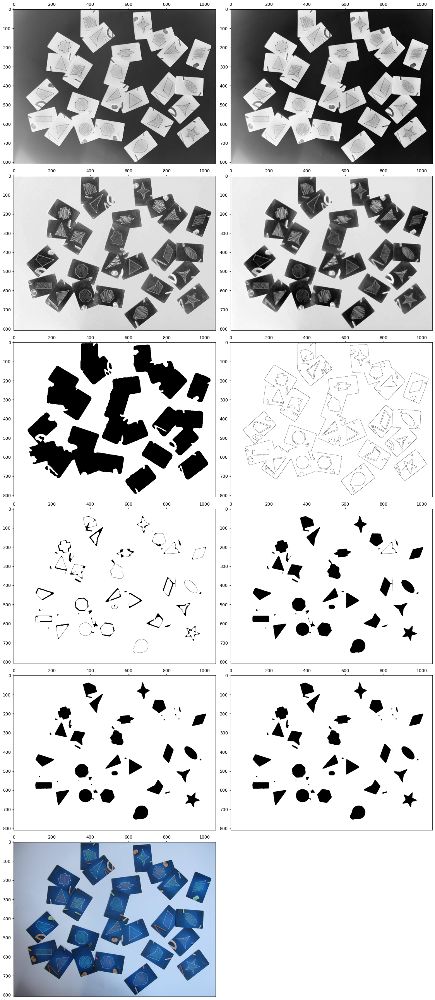

In [17]:
# i_ = []
# for img, res in zip(src_images, res_):
#     n_1 = to_1ch(img, mode='s') * res
#     m_1 = to_1ch(img, mode='v') * res
#     l_1 = n_1 * m_1
# #     n_2 = canny(n_1, sigma=2)
#     i_ += [n_1, l_1, match_histograms(n_1, l_1)]#(histogram(n_1)[::-1])],# bg_filter(n_1, thr_a=20, thr_b = 240, factor=0.4)]
# show_images(i_, n_in_row=3, factor_r=6, factor_c=8)

def eq_(img):
    img = equalize_hist(img)
    img = rank.equalize(img, disk(40))
    return img

i_ = []
for img, res in zip([src_images[2]], [res_[0]]):
#     n_1 = to_1ch(img, mode='gray') * res
    s_ = to_1ch(img, mode='s')
    g_ = to_1ch(img, mode='gray')
#     l_1 = eq_(m_1)
#     k_1 = adjust_sigmoid(l_1) * res
#     c_1 = to_1ch(k_1)
    t_ = canny(g_, sigma=2)
    b_ = t_ * binary_erosion(res, disk(5))
    b_ = binary_closing(b_, disk(5))
    
    a_ = binary_fill_holes(b_, disk(1))
    mm = binary_opening(a_, diamond_kern(5)) #dilation(erosion(a_, diamond_kern(15)), disk(11))
    i_ += [g_, median(g_, square(3)), s_, median(s_, disk(3)), res, t_, b_, a_, mm, a_ * mm, img] #, m_1, l_1]#(histogram(n_1)[::-1])],# bg_filter(n_1, thr_a=20, thr_b = 240, factor=0.4)]
#     print(m_1)
show_images(i_, n_in_row=2, factor_r=6, factor_c=8)

In [18]:
from skimage.restoration import denoise_bilateral
import cv2

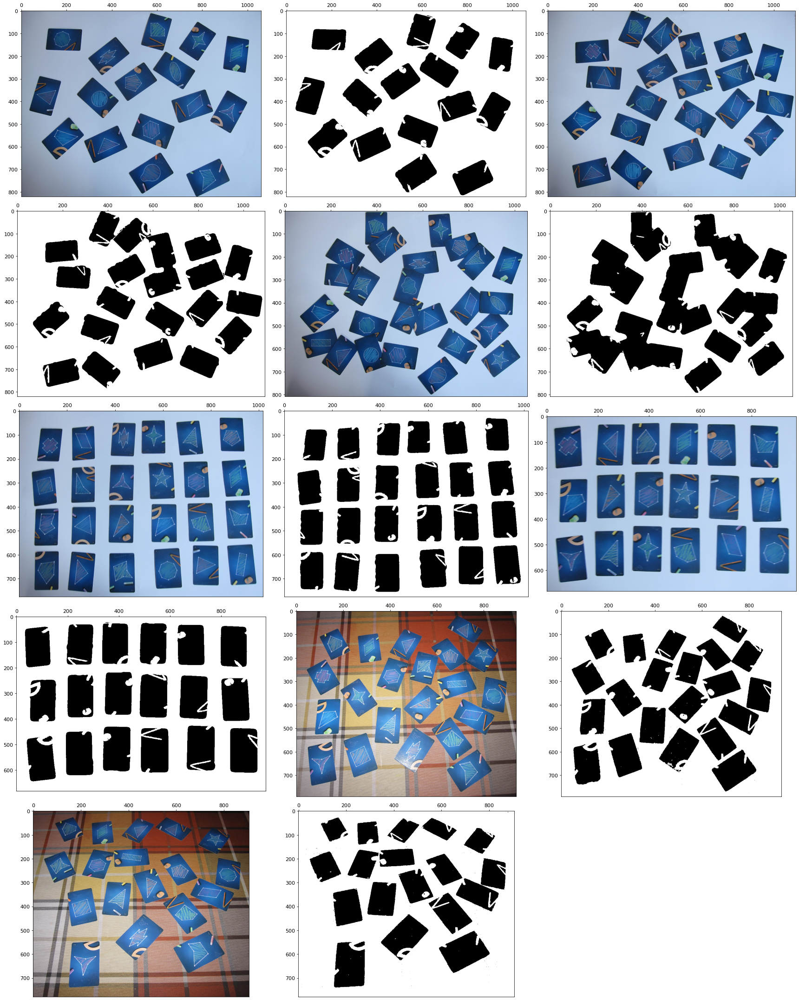

In [67]:
ans = []
for i, j in zip([1, 2, 4, 6, 7, 9, 10], range(7)):
    img = src_images[j]
#     img = cv2.bilateralFilter(img, d = 20, sigmaSpace = 300, sigmaColor =50)
    res = mask_objects(img)
    ans += [img, res]
    
show_images(ans, factor_r=6, factor_c=8)

# # show_images([img, img_], factor_r=6, factor_c=8)
# res = mask_objects(img)
# h_ = to_1ch(img, mode='h')
# show_images([res], factor_r=6, factor_c=8)

# s_ = to_1ch(img, mode='s')
# g_ = to_1ch(img, mode='gray')

# t_ = canny(g_, sigma=0.8)
# # t_ = cv2.Canny(image=img, threshold1=85, threshold2=75)
# b_ = t_ * binary_erosion(res, disk(3))
# b_ = binary_closing(b_, disk(3))
# a_ = binary_fill_holes(b_, disk(1))

# show_images([s_, g_, t_, b_, a_], factor_r=6, factor_c=8)

# show_image(to_1ch(img, mode='h'))

# 
# mm = binary_opening(a_, diamond_kern(5)) 
# [g_, median(g_, square(3)), s_, median(s_, disk(3)), res, t_, b_, a_, mm, a_ * mm, img]

In [ ]:
show_images(i_, n_in_row=2, factor_r=6, factor_c=8)

In [1136]:
for i in range(5, 7 + 1):
    print(i)
    
for i in range(5, 2-1, -1):
    print(i)

5
6
7
5
4
3
2


In [1129]:
a = np.array([0, 1, 2, 3, 4, 5, 6, 7])
t_a, t_b = 2, 5
# a[t_a:t_b+1]
a * ((a >= t_a) & (a <= t_b))

array([0, 0, 2, 3, 4, 5, 0, 0])

In [1127]:
((a > 0) & (a < 5))

array([False,  True,  True,  True,  True, False, False, False])

<module 'matplotlib.pyplot' from 'C:\\Users\\Kirill\\anaconda3\\envs\\py36\\lib\\site-packages\\matplotlib\\pyplot.py'>

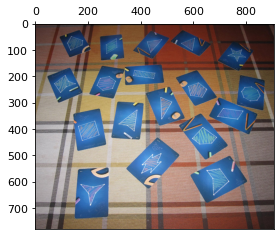

In [1073]:
show_image(img)

In [972]:
def clear_card(img):
    # mask_1
    grayscale_ = to_1ch(img, mode='h')
    contrast_ = adjust_sigmoid(grayscale_, cutoff=0.6)
    bin_ = to_bin(contrast_, thr='otsu')
    invert_ = invert(bin_)
    morph_ = opening(invert_, diamond_kern(4))
    mask_1 = morph_
    
    # mask_2
    grayscale_ = to_1ch(img, mode='h')
    contrast_ = adjust_sigmoid(grayscale_, cutoff=0.6)
    bin_ = to_bin(contrast_, thr=0.62)
    morph_ = opening(bin_, square_kern(5))
    mask_2 = morph_
    
    res = mask_1 + mask_2
    return res

In [833]:
y * (y > 200)

array([14156,   953,  2852,  8726,  9642, 13140, 15706, 35100, 33126,
       24779, 12340, 18134, 11387,  9770,  7243,  6749,  7749,  5149,
        6902, 13523, 12459, 21139,  8427, 13050, 12096, 12475, 11207,
       11082, 12869, 10644, 11360, 14048,  3984,  2098,  2101,  1402,
         714,   463,     0,   218,     0,     0,   922,     0,     0,
           0,     0,     0,     0,     0,   217,   215,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,

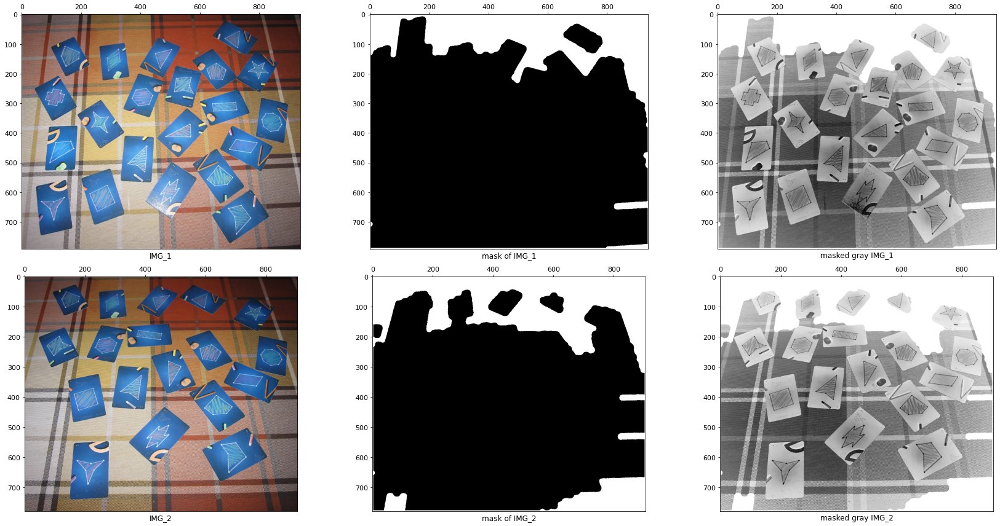

In [708]:
show_images(img_arr, name_arr, n_in_row=3, factor_r=6, factor_c=8)

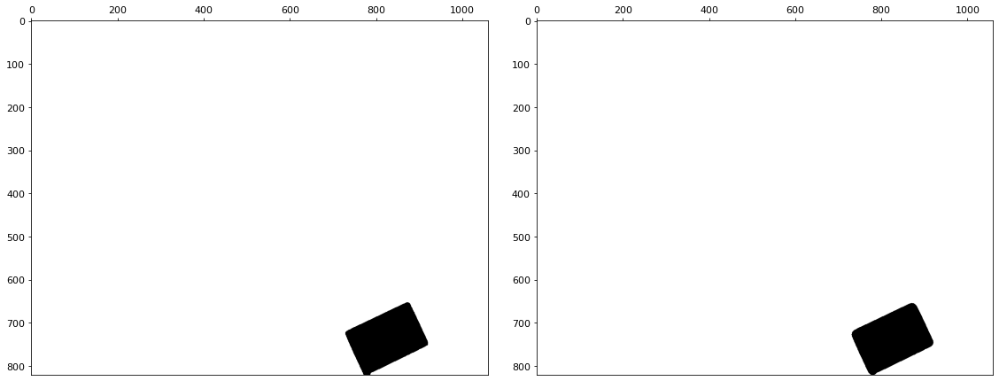

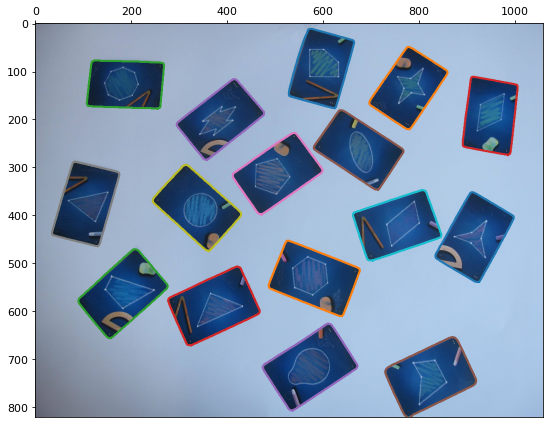

In [428]:
res_1 = images_canny[0][-2]
res_2 = res_1
res_3 = binary_fill_holes(res_2, disk(1))

mask_1 = binary_opening(res_3, disk(3)) * clear_border(binary_closing(res_3, disk(3)))

b_ = binary_closing(res_3, disk(5))
c_ = clear_border(binary_closing(res_3, disk(5)))
d_ = binary_fill_holes(b_ * invert(c_), disk(1))
mask_2 = binary_opening(d_, disk(12))
res_4 = mask_1 + mask_2

res_5 = binary_erosion(res_4, disk(3))

show_images([d_, mask_2], n_in_row=2, factor_r=6, factor_c=8)

# show_images([res_4, res_5, to_1ch(img_orig) * res_5], n_in_row=2, factor_r=6, factor_c=8)

plt_ = show_image(img_orig, factor_r=6, factor_c=8)
contours = measure.find_contours(res_4, 0.8)
for contour in contours:
    plt_.plot(contour[:, 1], contour[:, 0], linewidth=2)
plt.show()

In [ ]:
# binary_opening(res_3, diamond_kern(11))
# res_4 = binary_opening()

# show_images([res_1, res_2, res_3, res_4, img_orig], [images_canny[1][-2]], n_in_row=3, factor_r=6, factor_c=8)
# show_images([res_4, res_5, to_1ch(img_orig) * res_5], n_in_row=1, factor_r=6, factor_c=8)

# ,

# plt_ = show_image(img_orig, factor_r=6, factor_c=8)
# contours = measure.find_contours(res_4, 0.8)
# for contour in contours:
#     plt_.plot(contour[:, 1], contour[:, 0], linewidth=2)
# plt.show()

In [275]:
def show_images(img_arr, name_arr=[], n_in_row=3, factor_r=4, factor_c=4, figsize=None,
         title=None, cmap_='Greys', label_fontsize=12, tick_fontsize=11, save_path=None):
    if type(img_arr) is np.ndarray:
        quant = img_arr.shape[0]
    elif type(img_arr) is list:
        quant = len(img_arr)
    cols = min(quant, n_in_row)
    rows = quant // n_in_row + (1 if quant % n_in_row else 0)
    if figsize is None:
        figsize = (int(factor_c * cols), int(factor_r * rows))
    fig = plt.figure(figsize=figsize)
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    for i, img in enumerate(img_arr):
        ax = fig.add_subplot(rows, cols, i + 1)
        ax.imshow(img, cmap=cmap_)
        ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
        ax.xaxis.set_ticks_position('top')
        ax.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(f'{save_path}')
    plt.show()

In [274]:
def show_image(img, name='', factor_r=4, factor_c=4, figsize=None,
         title=None, cmap_='Greys', label_fontsize=12, tick_fontsize=11, save_path=None):
    fig = plt.figure(figsize=(factor_c, factor_r))
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    plt.imshow(img, cmap=cmap_)
    plt.xlabel(name, fontsize=label_fontsize)
    plt.gca().xaxis.set_ticks_position('top')
    plt.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(f'{save_path}')
    return plt

In [161]:
poly = approximate_polygon(res_4, tolerance=0.02)
show_images([res_4, poly])

ValueError: too many values to unpack (expected 2)

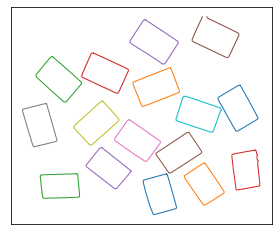

In [228]:
import numpy as np
import matplotlib.pyplot as plt

from skimage import measure


# Construct some test data
x, y = np.ogrid[-np.pi:np.pi:100j, -np.pi:np.pi:100j]
r = np.sin(np.exp((np.sin(x)**3 + np.cos(y)**2)))

# Find contours at a constant value of 0.8
contours = measure.find_contours(res_4, 0.8)

# Display the image and plot all contours found
fig, ax = plt.subplots()
# ax.imshow(res_4)

for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=1)

ax.axis('image')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

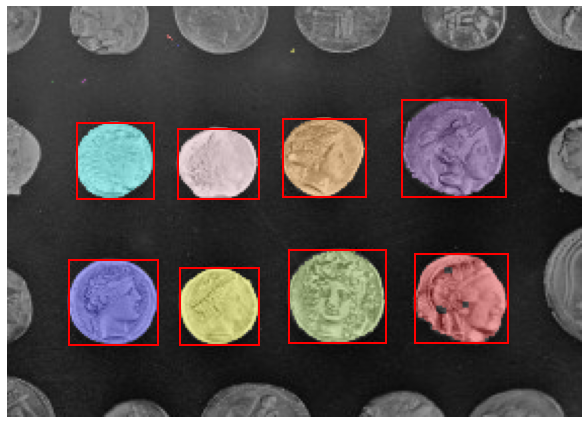

In [163]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from skimage import data
from skimage.filters import threshold_otsu
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import closing, square
from skimage.color import label2rgb


image = data.coins()[50:-50, 50:-50]

# apply threshold
thresh = threshold_otsu(image)
bw = closing(image > thresh, square(3))

# remove artifacts connected to image border
cleared = clear_border(bw)

# label image regions
label_image = label(cleared)
# to make the background transparent, pass the value of `bg_label`,
# and leave `bg_color` as `None` and `kind` as `overlay`
image_label_overlay = label2rgb(label_image, image=image, bg_label=0)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(image_label_overlay)

for region in regionprops(label_image):
    # take regions with large enough areas
    if region.area >= 100:
        # draw rectangle around segmented coins
        minr, minc, maxr, maxc = region.bbox
        rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                                  fill=False, edgecolor='red', linewidth=2)
        ax.add_patch(rect)

ax.set_axis_off()
plt.tight_layout()
plt.show()

### Маска лишних объектов на карточках

In [ ]:
img_cropped = img_orig[40:210, 80:295]
show_images([img_cropped])

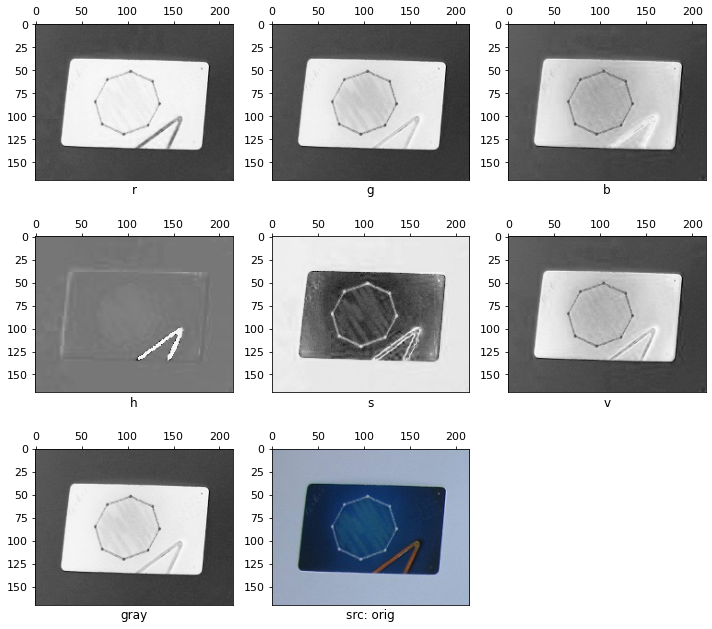

In [15]:
transf_1ch_names = ['r', 'g', 'b', 'h', 's', 'v', 'gray']
transf_1ch_arr = [(lambda img, mode=mode_: to_1ch(img, mode=mode)) for mode_ in transf_1ch_names]

show_images(*get_all_transf(img_cropped, transf_1ch_arr, transf_1ch_names, src='src: orig'), factor_r=3, factor_c=3.5)

In [16]:
hue_mask = to_1ch(img_orig, mode='h')

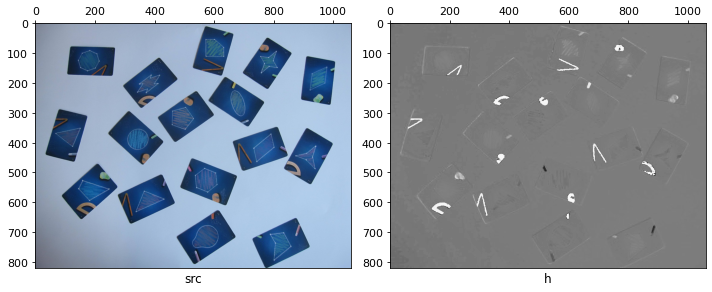

In [17]:
show_images([img_orig, hue_mask], ['src', 'h'], factor_r=5, factor_c=5)

Сделаем тёмные элементы пиксели, а светлые - светлее $\Rightarrow$ преобразуем гистограмму сигмоидой

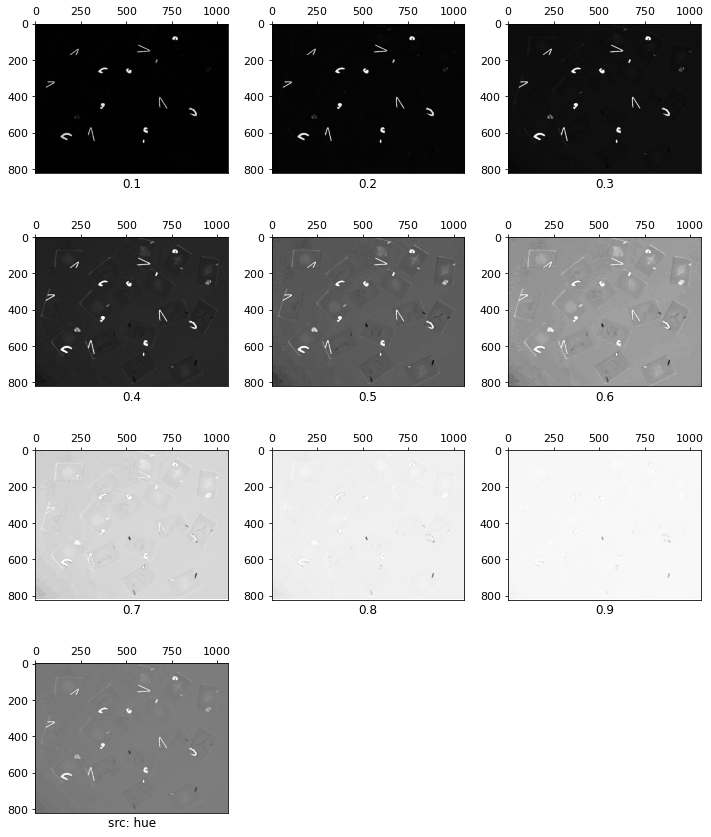

In [18]:
transf_sigm_names = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
transf_sigm_arr = [(lambda img, cutoff=cutoff_: adjust_sigmoid(img, cutoff=cutoff)) for cutoff_ in transf_sigm_names]

img_sigm = get_all_transf(hue_mask, transf_sigm_arr, transf_sigm_names, src='src: hue')
show_images(*img_sigm, factor_r=3, factor_c=3.5)

Лишние элементы на карточках выделяются при `cutoff` $\in \{0.4, 0.5, 0.6, 0.7\}$, сделаем бинаризацию Оцу:

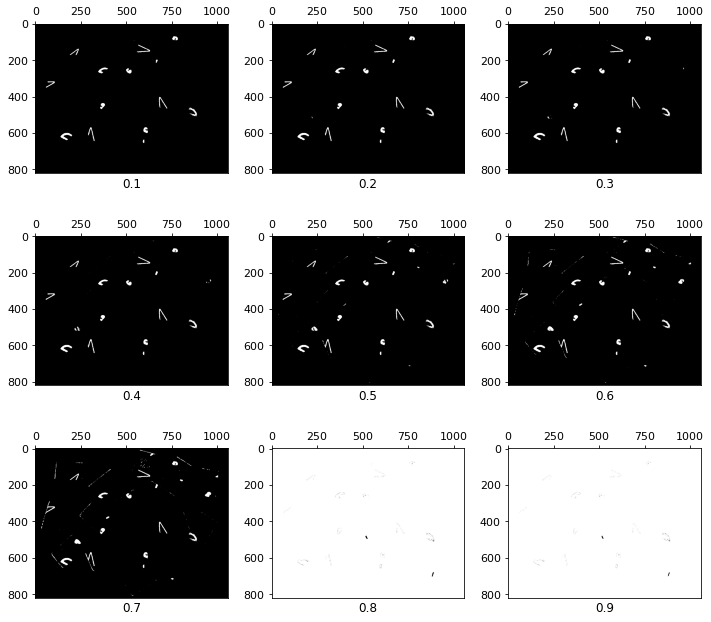

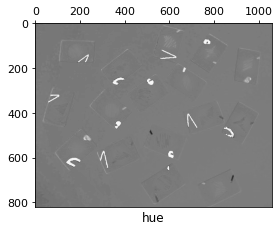

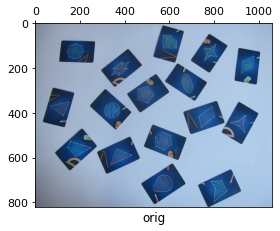

In [19]:
img_bin = ([], img_sigm[1][:-1])
for img_ in img_sigm[0][:-1]:
    img_bin[0].append(to_bin(img_))
    

show_images(*img_bin, factor_r=3, factor_c=3.5)
show_images([img_sigm[0][-1]], ['hue'])
show_images([img_orig], ['orig'])

После бинаризации Оцу видно, что "белые" элементы лучше всего выделяются при сигмоиде с `cutoff` $= 0.6$. Найдём порог для выделения "чёрных" элементов на изображении с той же сигмоидой $0.6$:

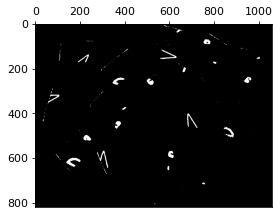

In [20]:
img_sigm06_otsu = img_bin[0][5]
show_images([img_sigm06_otsu])

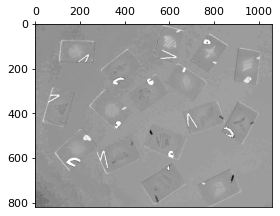

In [21]:
img_sigm06 = img_sigm[0][5]
show_images([img_sigm06])

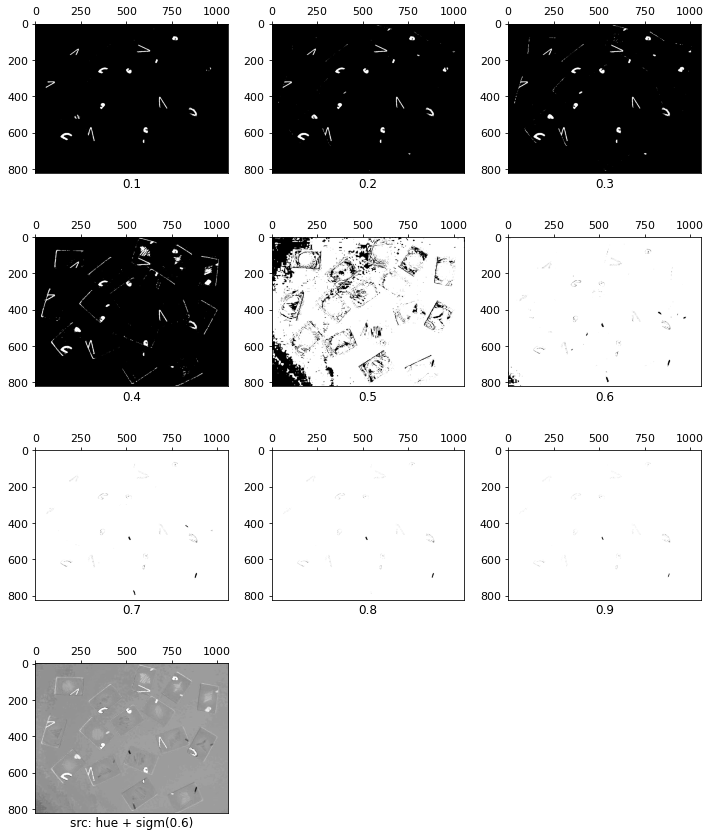

In [22]:
transf_bin_names = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
transf_bin_arr = [(lambda img, thr=thr_: to_bin(img, thr=thr)) for thr_ in transf_bin_names]

img_bin = get_all_transf(img_sigm06, transf_bin_arr, transf_bin_names, src='src: hue + sigm(0.6)')
show_images(*img_bin, factor_r=3, factor_c=3.5)

Видим, что нужно искать `thr` $\in [0.6, 0.7]$, $0.6$ почти подходит:

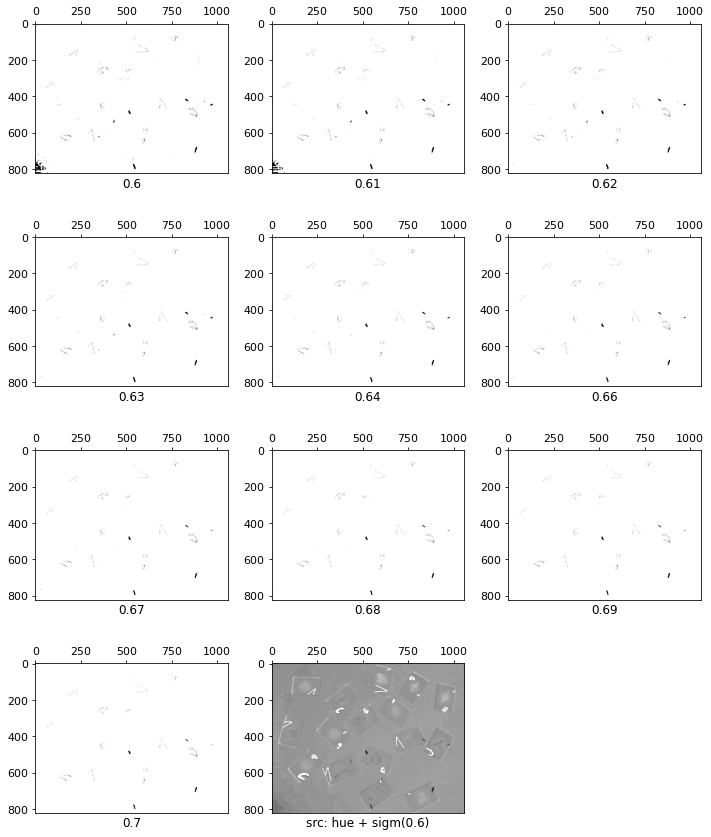

In [23]:
transf_bin_names = list(np.linspace(0.6, 0.7, 10).round(2))
transf_bin_arr = [(lambda img, thr=thr_: to_bin(img, thr=thr)) for thr_ in transf_bin_names]

img_bin = get_all_transf(img_sigm06, transf_bin_arr, transf_bin_names, src='src: hue + sigm(0.6)')
show_images(*img_bin, factor_r=3, factor_c=3.5)

Здесь возьмём `thr`$= 0.62$:

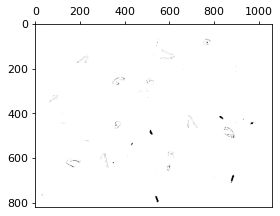

In [24]:
img_sigm06_bin062 = img_bin[0][2]
show_images([img_sigm06_bin062])

In [25]:
img_sigm06_otsu = invert(img_sigm06_otsu)

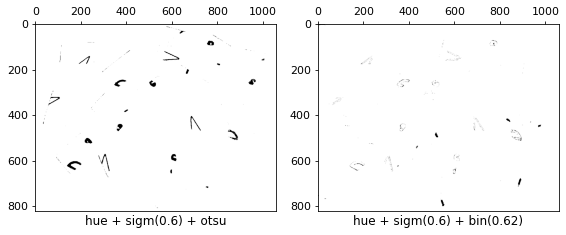

In [26]:
show_images([img_sigm06_otsu, img_sigm06_bin062], ['hue + sigm(0.6) + otsu', 'hue + sigm(0.6) + bin(0.62)'])

Нужно убрать небольшие помехи $-$ посмотрим на размыкание:

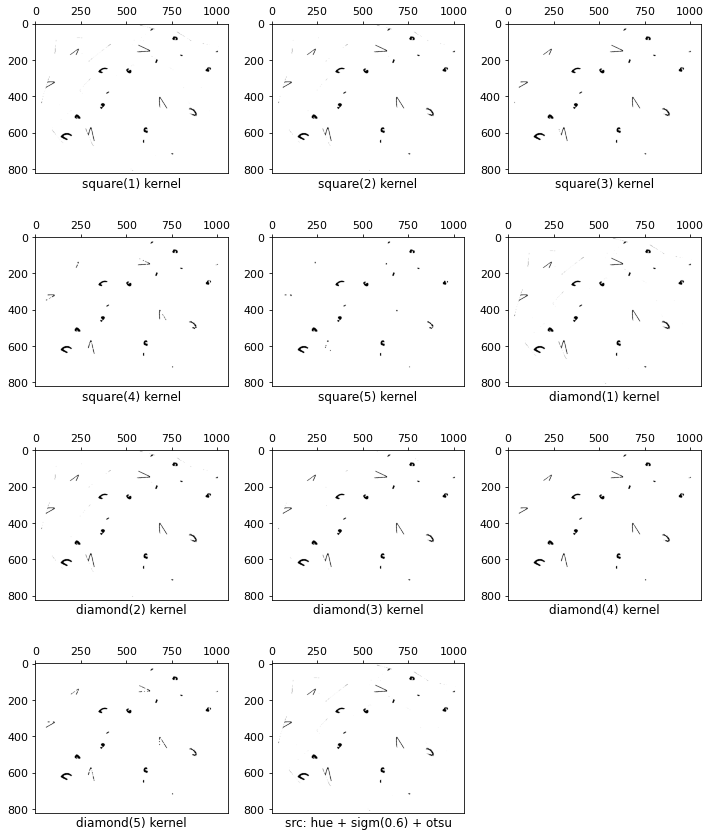

In [27]:
transf_morph_arr = ([(lambda img, d=d_: opening(img, square_kern(d))) for d_ in list(np.arange(1, 6))] + 
                    [(lambda img, d=d_: opening(img, diamond_kern(d))) for d_ in list(np.arange(1, 6))])
transf_morph_names = [f'{type_}({i}) kernel' for type_ in ['square', 'diamond'] for i in np.arange(1, 6)]

img_morph = get_all_transf(img_sigm06_otsu, transf_morph_arr, transf_morph_names, src='src: hue + sigm(0.6) + otsu')
show_images(*img_morph, factor_r=3, factor_c=3.5)

Лучше всего справился `diamond(4) kernel`

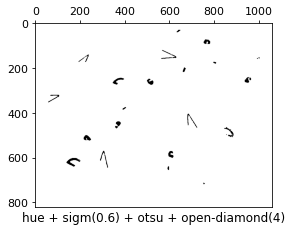

In [28]:
mask_1 = ([img_morph[0][8]], ['hue + sigm(0.6) + otsu + open-diamond(4)'])
show_images(*mask_1)

Теперь уберём лишнее со второй части маски:

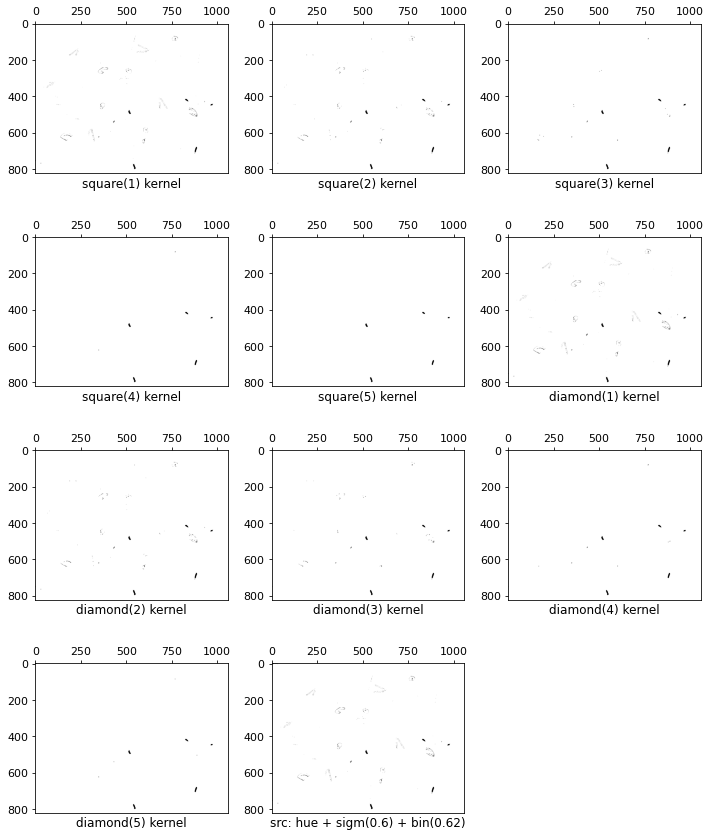

In [29]:
transf_morph_arr = ([(lambda img, d=d_: opening(img, square_kern(d))) for d_ in list(np.arange(1, 6))] + 
                    [(lambda img, d=d_: opening(img, diamond_kern(d))) for d_ in list(np.arange(1, 6))])
transf_morph_names = [f'{type_}({i}) kernel' for type_ in ['square', 'diamond'] for i in np.arange(1, 6)]

img_morph = get_all_transf(img_sigm06_bin062, transf_morph_arr, transf_morph_names, src='src: hue + sigm(0.6) + bin(0.62)')
show_images(*img_morph, factor_r=3, factor_c=3.5)

А здесь лучше всего справился `square(5) kernel`

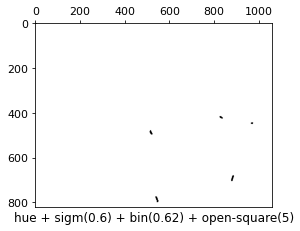

In [30]:
mask_2 = ([img_morph[0][4]], ['hue + sigm(0.6) + bin(0.62) + open-square(5)'])
show_images(*mask_2)

Объединим маски, исключающие лишнее на карточках:

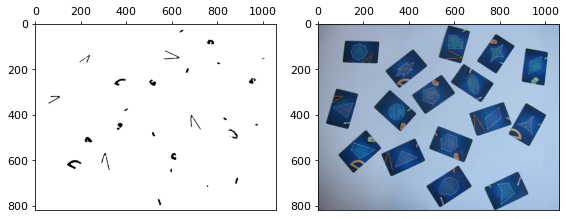

In [31]:
mask_1 = mask_1[0][0] + mask_2[0][0]
show_images([mask_1, img_orig])

Итого:

In [48]:
def clear_card(img):
    # mask_1
    grayscale_ = to_1ch(img, mode='h')
    contrast_ = adjust_sigmoid(grayscale_, cutoff=0.6)
    bin_ = to_bin(contrast_, thr='otsu')
    invert_ = invert(bin_)
    morph_ = opening(invert_, diamond_kern(4))
    mask_1 = morph_
    
    # mask_2
    grayscale_ = to_1ch(img, mode='h')
    contrast_ = adjust_sigmoid(grayscale_, cutoff=0.6)
    bin_ = to_bin(contrast_, thr=0.62)
    morph_ = opening(bin_, square_kern(5))
    mask_2 = morph_
    
    res = mask_1 + mask_2
    return res

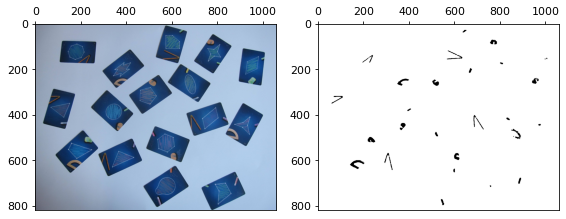

In [49]:
show_images([img_orig, clear_card(img_orig)])

### Выделение карточек

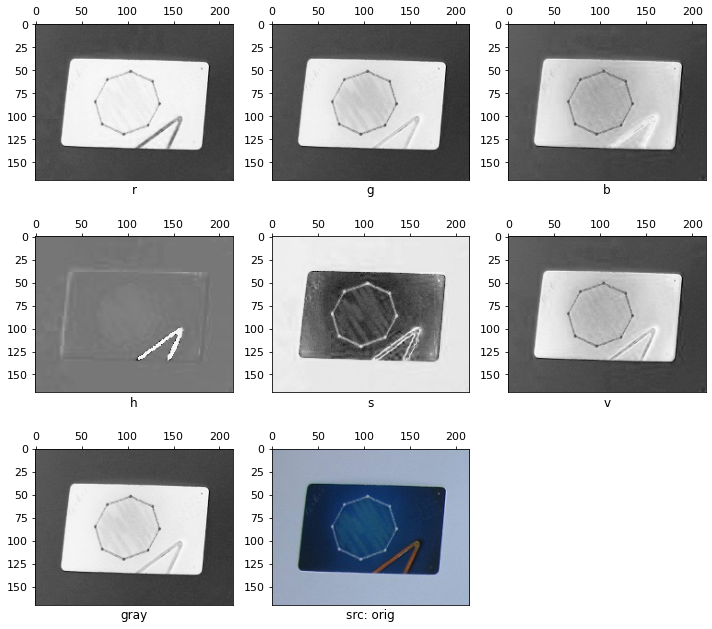

In [32]:
transf_1ch_names = ['r', 'g', 'b', 'h', 's', 'v', 'gray']
transf_1ch_arr = [(lambda img, mode=mode_: to_1ch(img, mode=mode)) for mode_ in transf_1ch_names]

images = get_all_transf(img_cropped, transf_1ch_arr, transf_1ch_names, src='src: orig')
show_images(*images, factor_r=3, factor_c=3.5)

Определяем границу с помощью алгоритма Кэнни:

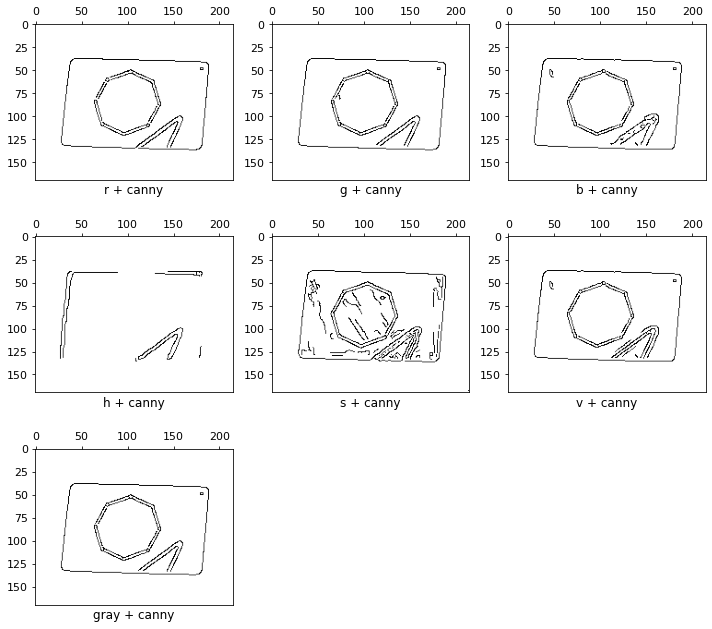

In [33]:
transf_canny_names = [s + ' + canny' for s in transf_1ch_names]

images_canny = get_transf_of_all(images[0][:-1], lambda img: canny(img), transf_canny_names)
show_images(*images_canny, factor_r=3, factor_c=3.5)

Нам подходит сведение к полутоновому изображению `gray` и выделение границ с помощью алгоритма Кэнни

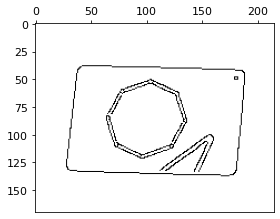

In [54]:
img_bordered = images_canny[0][-1]
show_images([img_bordered])

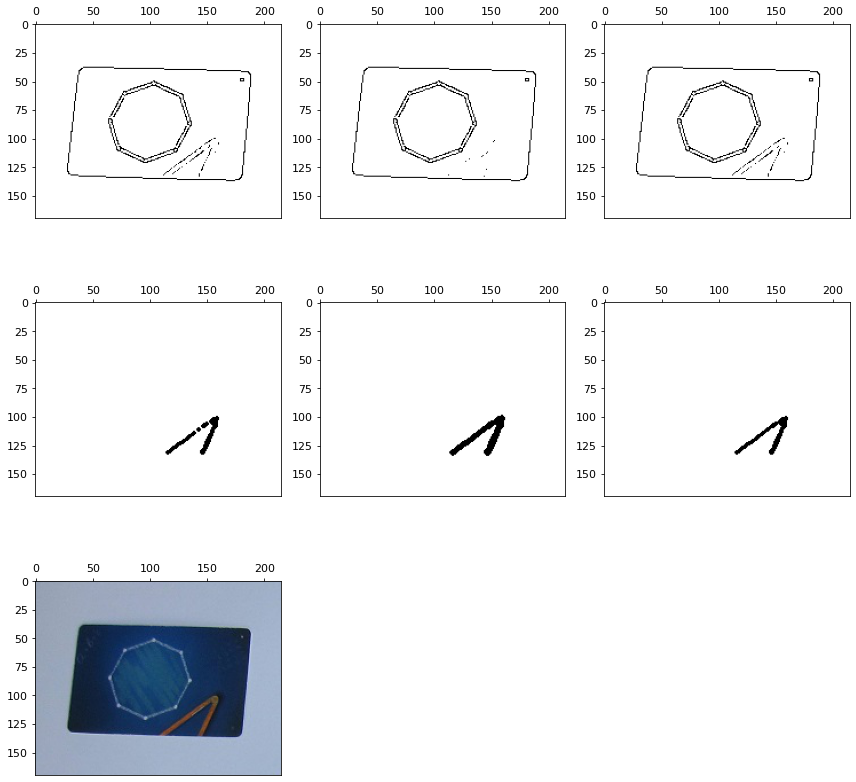

In [120]:
img_ = img_cropped
clear_mask = clear_card(img_)
img_bordered = canny(to_1ch(img_, mode='gray'))
masks_ = [clear_mask, dilation(clear_mask, disk(1)), binary_closing(clear_mask, disk(2))]
res_ = [img_bordered * invert(m_) for m_ in masks_]
show_images(res_ + masks_ + [img_])

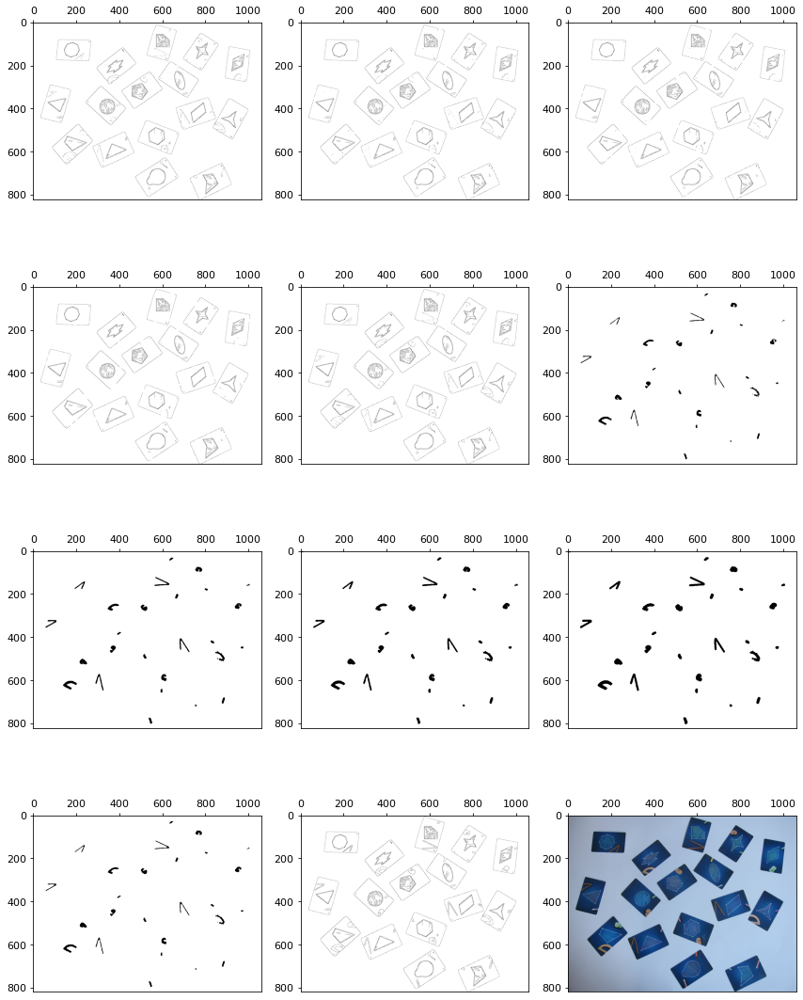

In [125]:
img_ = img_orig
clear_mask = clear_card(img_)
img_bordered = canny(to_1ch(img_, mode='gray'))
masks_ = [clear_mask, dilation(clear_mask, disk(1)), dilation(clear_mask, disk(2)), dilation(clear_mask, disk(3)), binary_closing(clear_mask, disk(2))]
res_ = [img_bordered * invert(m_) for m_ in masks_]
show_images(res_ + masks_ + [img_bordered] + [img_])

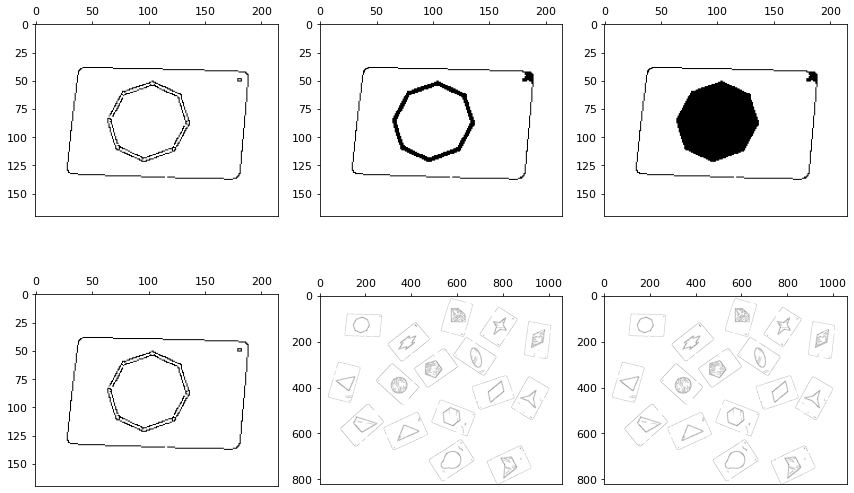

In [158]:
ok = res_[3]
clear_mask = clear_card(img_cropped)
bord =  canny(to_1ch(img_cropped, mode='gray')) * invert(dilation(clear_mask, disk(2)))
bord_2 = binary_closing(bord, disk(3))
bord_3 = binary_fill_holes(bord_2)
show_images([bord, bord_2, bord_3, clear_border(bord), ok, clear_border(ok)])